# Processing Pipeline for `scRNA-seq` Data

This notebook presents a single cell RNA sequencing analysis. The input data
were obtained from GEO: GSE158702.

In [1]:
# Edit the variable below to point at a valid MEX scRNA-seq dataset.
dataset_filepath = "../data/fawkner-corbett-sc-epi3/raw_feature_bc_matrix"

In [2]:
import scanpy as sc
import anndata as ad
import pandas as pd

sc.settings.set_figure_params(dpi=100, facecolor="white")

# Read and Visualize Data

In [ ]:
data = sc.read_10x_mtx(dataset_filepath)

In [4]:
print(f"The dataset contains:")
print(f"- {len(data.var.index)} features (i.e. genes).")
print(f"- {len(data.obs.index)} observations (i.e. cells).")

The dataset contains:
- 33538 features (i.e. genes).
- 6794880 observations (i.e. cells).


In [20]:
# mitochondrial genes, "MT-" for human, "Mt-" for mouse
data.var["mt"] = data.var_names.str.startswith("MT-")
# ribosomal genes
data.var["ribo"] = data.var_names.str.startswith(("RPS", "RPL"))

In [52]:
sc.pp.calculate_qc_metrics(
    data, qc_vars=["mt", "ribo"], inplace=True, log1p=True
)

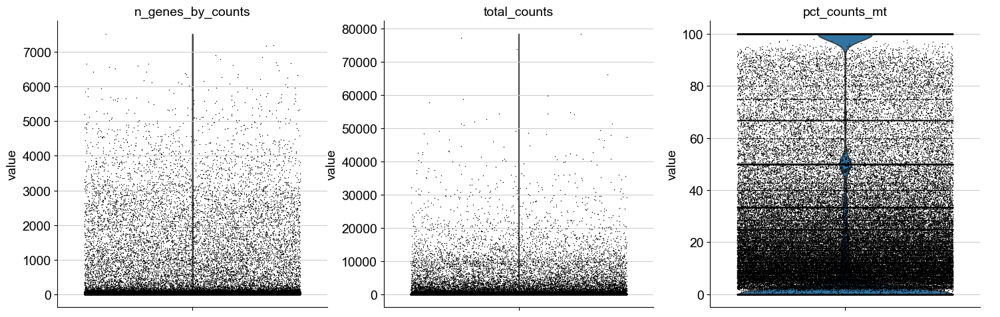

In [53]:
sc.pl.violin(
    data,
    ["n_genes_by_counts", "total_counts", "pct_counts_mt"],
    jitter=0.4,
    multi_panel=True,
)

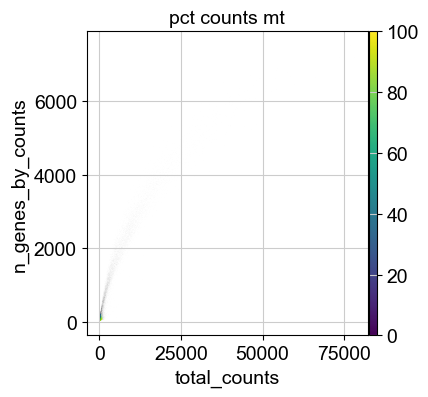

In [54]:
sc.pl.scatter(data, "total_counts", "n_genes_by_counts", color="pct_counts_mt")

# Filter Poor Quality Readings Out

Remove uncommon and rare genes.

In [21]:
sc.pp.filter_cells(data, min_genes=100)
sc.pp.filter_genes(data, min_cells=3)
print(f"The dataset contains:")
print(f"- {len(data.var.index)} features (i.e. genes).")
print(f"- {len(data.obs.index)} observations (i.e. cells).")

The dataset contains:
- 21961 features (i.e. genes).
- 12991 observations (i.e. cells).


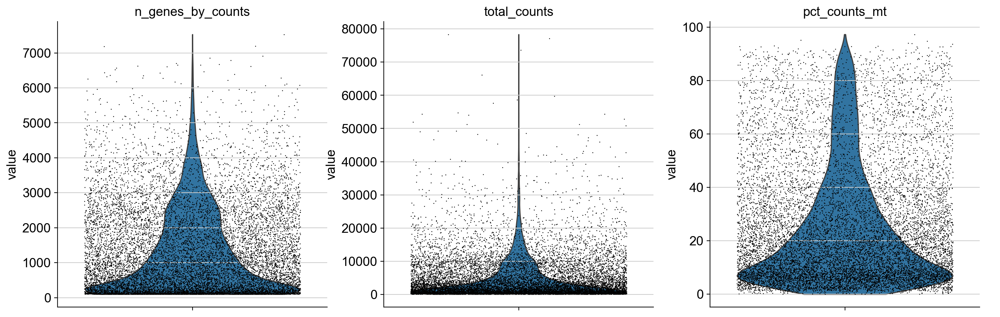

In [23]:
sc.pp.calculate_qc_metrics(
    data, qc_vars=["mt", "ribo"], inplace=True, log1p=True
)
sc.pl.violin(
    data,
    ["n_genes_by_counts", "total_counts", "pct_counts_mt"],
    jitter=0.4,
    multi_panel=True,
)

Remove cells with more than 20 % mtRNA.

In [24]:
data = data[data.obs['pct_counts_mt'] < 20, :]

d:\uqam\bif7104\easy-st\venv\Lib\site-packages\scanpy\preprocessing\_qc.py:140: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[obs_metrics.columns] = obs_metrics


The dataset contains:
- 21961 features (i.e. genes).
- 7122 observations (i.e. cells).


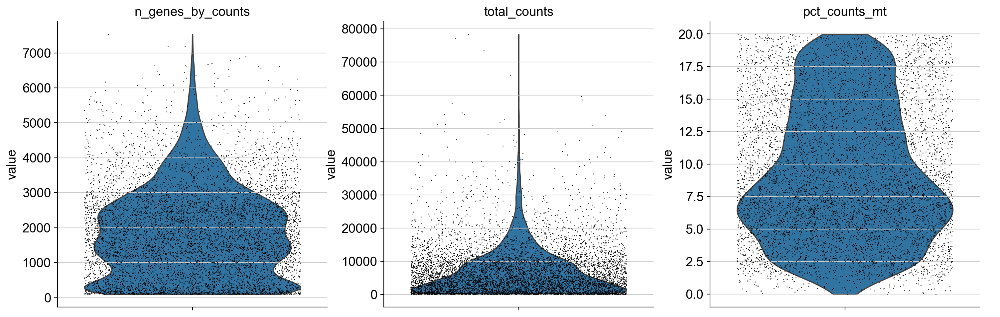

In [9]:
sc.pp.calculate_qc_metrics(
    data, qc_vars=["mt", "ribo"], inplace=True, log1p=True
)
print(f"The dataset contains:")
print(f"- {len(data.var.index)} features (i.e. genes).")
print(f"- {len(data.obs.index)} observations (i.e. cells).")
sc.pl.violin(
    data,
    ["n_genes_by_counts", "total_counts", "pct_counts_mt"],
    jitter=0.4,
    multi_panel=True,
)

# Normalization

In [25]:
# Saving count data
data.layers["counts"] = data.X.copy()

# Normalizing to median total counts
sc.pp.normalize_total(data)
# Logarithmize the data
sc.pp.log1p(data)
data.uns['log1p']["base"] = None  # https://github.com/scverse/scanpy/issues/2239

C:\Users\vince\AppData\Local\Temp\ipykernel_4956\3030659598.py:2: ImplicitModificationWarning: Setting element `.layers['counts']` of view, initializing view as actual.
  data.layers["counts"] = data.X.copy()


# Feature Selection

Identify highly variable features (i.e. genes).

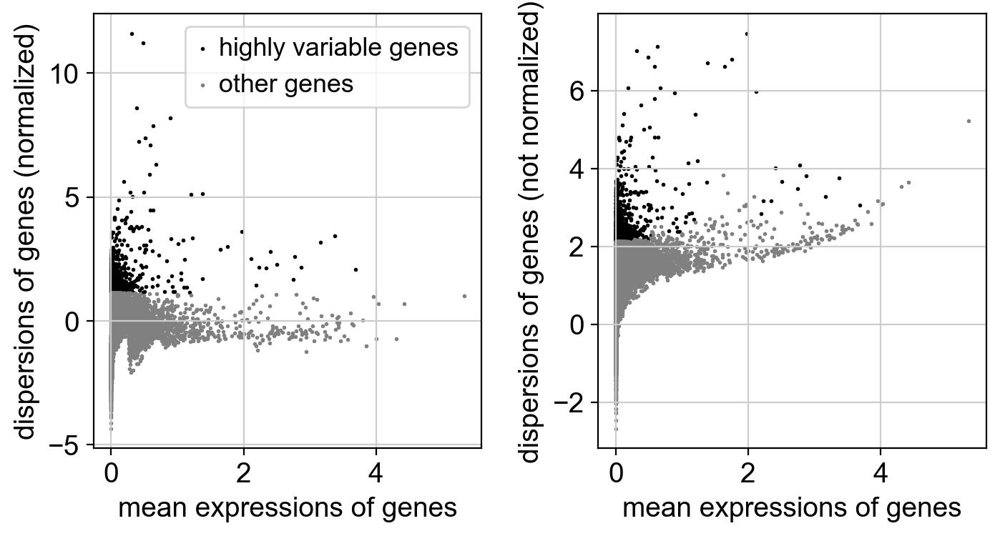

In [26]:
sc.pp.highly_variable_genes(data, n_top_genes=2000)
sc.pl.highly_variable_genes(data)

# Dimensionality Reduction

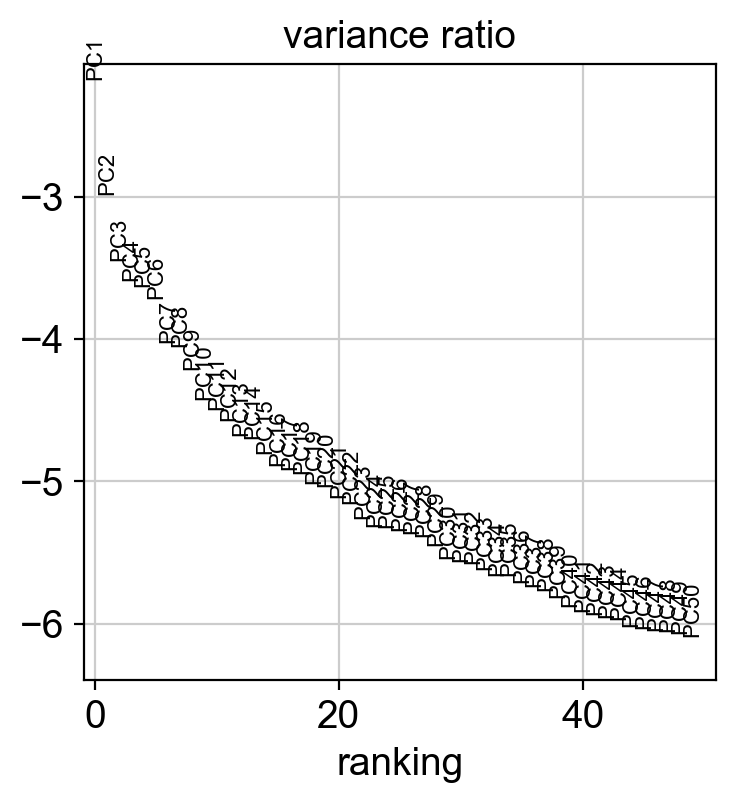

In [27]:
sc.tl.pca(data)
sc.pl.pca_variance_ratio(data, n_pcs=50, log=True)

In [28]:
df_loadings = pd.DataFrame(data.varm['PCs'], index=data.var_names)
df_rankings = pd.DataFrame((-1 * df_loadings.values).argsort(0).argsort(0), index=df_loadings.index, columns=df_loadings.columns)
print(df_loadings[0].sort_values())

VIM        -0.146613
TUBA1A     -0.134287
MEG3       -0.126672
HSP90AA1   -0.109232
CALD1      -0.092337
              ...   
TTR         0.280184
MT1H        0.302038
PHGR1       0.321926
MT1G        0.342844
FABP1       0.360828
Name: 0, Length: 21961, dtype: float64


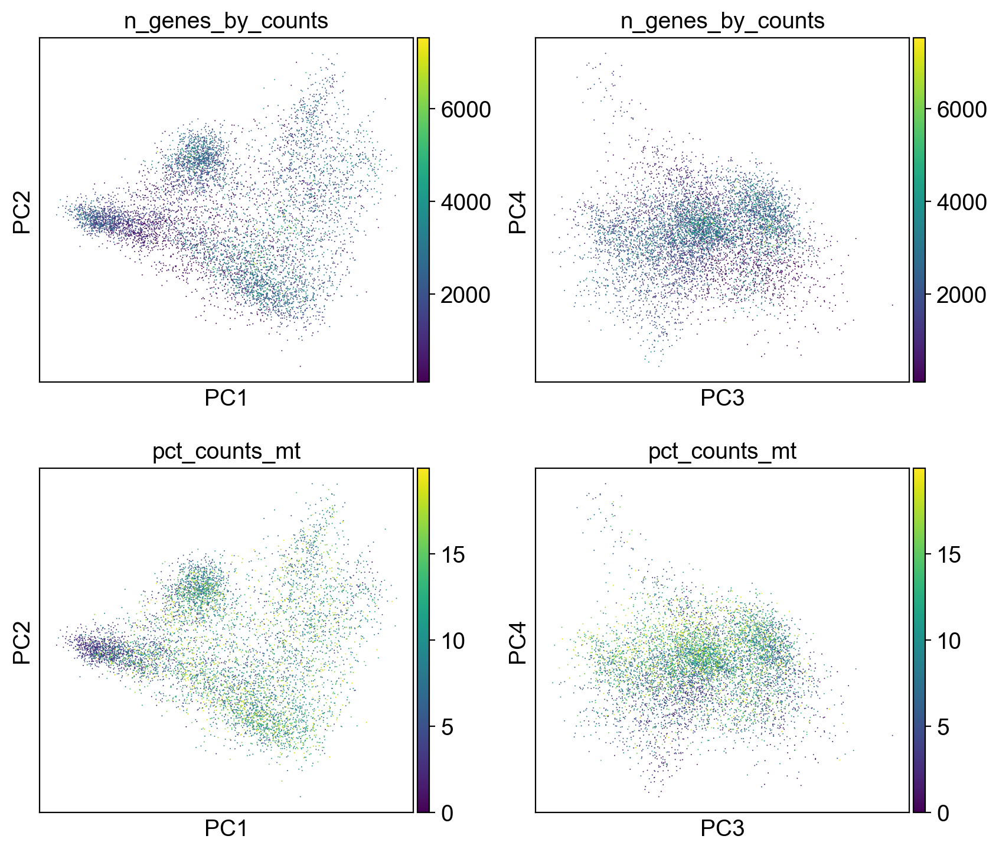

In [29]:
sc.pl.pca(
    data,
    color=["n_genes_by_counts", "n_genes_by_counts", "pct_counts_mt", "pct_counts_mt"],
    dimensions=[(0, 1), (2, 3), (0, 1), (2, 3)],
    ncols=2,
    size=2,
)

# Nearest Neighbor Graph Construction

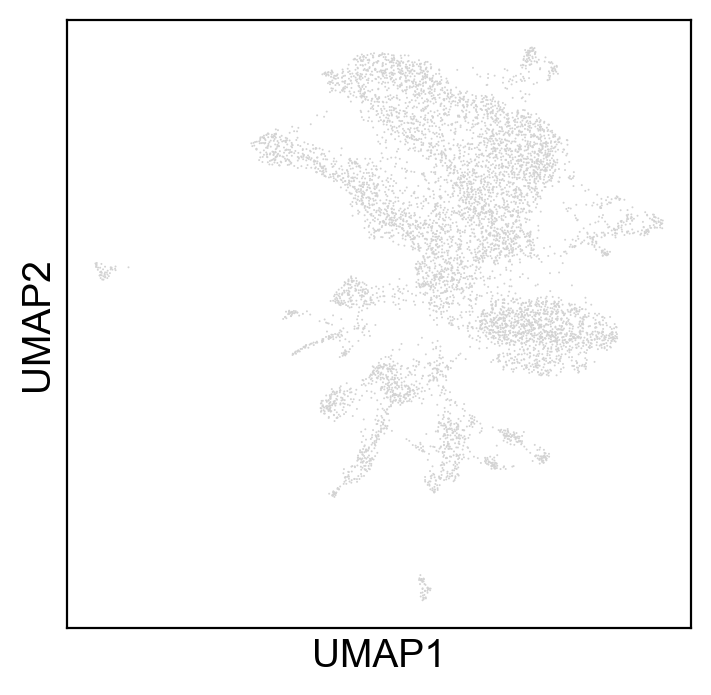

In [30]:
sc.pp.neighbors(data)
sc.tl.umap(data)
sc.pl.umap(
    data,
    # Setting a smaller point size to get prevent overlap
    size=2,
)

# Clustering

In [31]:
# Using the igraph implementation and a fixed number of iterations can be significantly faster, especially for larger datasets
sc.tl.leiden(data, flavor="igraph", n_iterations=2)
sc.pl.umap(data, color=["leiden"])

Exception ignored in: <class 'ValueError'>
Traceback (most recent call last):
  File "mtrand.pyx", line 746, in numpy.random.mtrand.RandomState.randint
  File "_bounded_integers.pyx", line 1336, in numpy.random._bounded_integers._rand_int32
ValueError: high is out of bounds for int32
Exception ignored in: <class 'ValueError'>
Traceback (most recent call last):
  File "mtrand.pyx", line 746, in numpy.random.mtrand.RandomState.randint
  File "_bounded_integers.pyx", line 1336, in numpy.random._bounded_integers._rand_int32
ValueError: high is out of bounds for int32
Exception ignored in: <class 'ValueError'>
Traceback (most recent call last):
  File "mtrand.pyx", line 746, in numpy.random.mtrand.RandomState.randint
  File "_bounded_integers.pyx", line 1336, in numpy.random._bounded_integers._rand_int32
ValueError: high is out of bounds for int32
Exception ignored in: <class 'ValueError'>
Traceback (most recent call last):
  File "mtrand.pyx", line 746, in numpy.random.mtrand.RandomState.r

Exception ignored in: <class 'ValueError'>
Traceback (most recent call last):
  File "mtrand.pyx", line 746, in numpy.random.mtrand.RandomState.randint
  File "_bounded_integers.pyx", line 1336, in numpy.random._bounded_integers._rand_int32
ValueError: high is out of bounds for int32
Exception ignored in: <class 'ValueError'>
Traceback (most recent call last):
  File "mtrand.pyx", line 746, in numpy.random.mtrand.RandomState.randint
  File "_bounded_integers.pyx", line 1336, in numpy.random._bounded_integers._rand_int32
ValueError: high is out of bounds for int32
Exception ignored in: <class 'ValueError'>
Traceback (most recent call last):
  File "mtrand.pyx", line 746, in numpy.random.mtrand.RandomState.randint
  File "_bounded_integers.pyx", line 1336, in numpy.random._bounded_integers._rand_int32
ValueError: high is out of bounds for int32
Exception ignored in: <class 'ValueError'>
Traceback (most recent call last):
  File "mtrand.pyx", line 746, in numpy.random.mtrand.RandomState.r

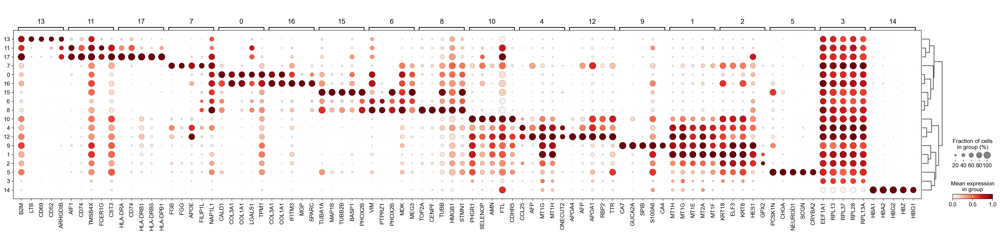

In [37]:
sc.tl.leiden(
    data, key_added=f"leiden_res_0.50", flavor="igraph"
)
sc.tl.rank_genes_groups(data, groupby="leiden_res_0.50", method="wilcoxon")
sc.pl.rank_genes_groups_dotplot(
    data, groupby="leiden_res_0.50", standard_scale="var", n_genes=5
)

In [41]:
sc.get.rank_genes_groups_df(data, group="7")

,names,scores,logfoldchanges,pvals,pvals_adj
0,FGB,43.943562,4.642942,0.000000e+00,0.000000e+00
1,FGG,39.997654,4.989877,0.000000e+00,0.000000e+00
2,APOE,39.575550,3.333319,0.000000e+00,0.000000e+00
3,FILIP1L,33.699162,3.329592,5.946659e-249,3.264864e-245
4,NAP1L1,33.465771,1.970931,1.517732e-245,6.666184e-242
...,...,...,...,...,...
21956,IER2,-21.692093,-1.552039,2.436476e-104,8.493247e-102
21957,LGALS4,-23.280060,-4.264897,7.059791e-120,3.370436e-117
21958,NEAT1,-23.291359,-1.986788,5.423783e-120,2.646926e-117
21959,MT1G,-23.329548,-3.093653,2.223294e-120,1.135483e-117
